### 0. Imports

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [2]:
chessboard_folder = 'data/chessboard'
chess_pieces_folder = 'data/chess_pieces'

### 1. Preprocess Image

In [10]:
def reorder_points(pts):
    """
    Sort corners into order: 
        [top-left, top-right, bottom-right, bottom-left]
    """
    pts = pts.astype(np.float32)
    s = pts.sum(axis=1)
    diff = np.diff(pts, axis=1)

    ordered = np.zeros((4, 2), dtype=np.float32)
    ordered[0] = pts[np.argmin(s)]      # top-left
    ordered[2] = pts[np.argmax(s)]      # bottom-right
    ordered[1] = pts[np.argmin(diff)]   # top-right
    ordered[3] = pts[np.argmax(diff)]   # bottom-left
    return ordered

def detect_corners(img):
    """
    Inspired by Sudoku detection approach:
    1) Grayscale, blur
    2) Adaptive threshold
    3) Morphological closing
    4) Find largest contour that isn't too small or too large
    5) Approximate to 4 corners -> return
    6) Otherwise fallback to rotated bounding box
    """
    # 1) Grayscale + blur
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.GaussianBlur(gray, (5,5), 0)
    
    # 2) Adaptive threshold (makes the board region bright/white)
    #    We invert so that the board is white on black background
    thresh = cv2.adaptiveThreshold(
        gray_blur, 
        255, 
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
        cv2.THRESH_BINARY, 
        11,    # blockSize
        2      # C constant subtracted from mean
    )
    # Invert: the board area becomes white, background black
    thresh = cv2.bitwise_not(thresh)

    # 3) Morphological closing to fill gaps in the board edges
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
    closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)

    # 4) Find contours in the closed image
    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None

    # Sort by descending area
    contours = sorted(contours, key=cv2.contourArea, reverse=True)
    img_area = img.shape[0] * img.shape[1]

    # Attempt to find a 4-corner polygon
    for cnt in contours:
        area = cv2.contourArea(cnt)
        # Filter out tiny or massive (entire image) contours
        if area < 0.02 * img_area or area > 0.9 * img_area:
            continue

        # Approximate the contour
        peri = cv2.arcLength(cnt, True)
        approx = cv2.approxPolyDP(cnt, 0.02 * peri, True)
        
        # If we get 4 corners, reorder and return
        if len(approx) == 4:
            corners = approx.reshape(4, 2)
            return reorder_points(corners)

    # 5) Fallback: if no 4-corner polygon found, 
    #    use minAreaRect on the largest plausible contour
    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < 0.02 * img_area or area > 0.9 * img_area:
            continue
        rect = cv2.minAreaRect(cnt)   # ((cx,cy),(w,h),angle)
        box = cv2.boxPoints(rect)     # 4 corner points
        return reorder_points(box)

    return None

def warp_perspective(image, corners):
    def order_points(pts):
        rect = np.zeros((4, 2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0] = pts[np.argmin(s)]
        rect[2] = pts[np.argmax(s)]
        diff = np.diff(pts, axis=1)
        rect[1] = pts[np.argmin(diff)]
        rect[3] = pts[np.argmax(diff)]
        return rect
    
    image = np.array(image)

    rect = order_points(np.array(corners, dtype="float32"))
    (tl, tr, br, bl) = rect

    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    maxWidth = int(max(widthA, widthB))

    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxHeight = int(max(heightA, heightB))

    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]
    ], dtype="float32")

    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
    return warped

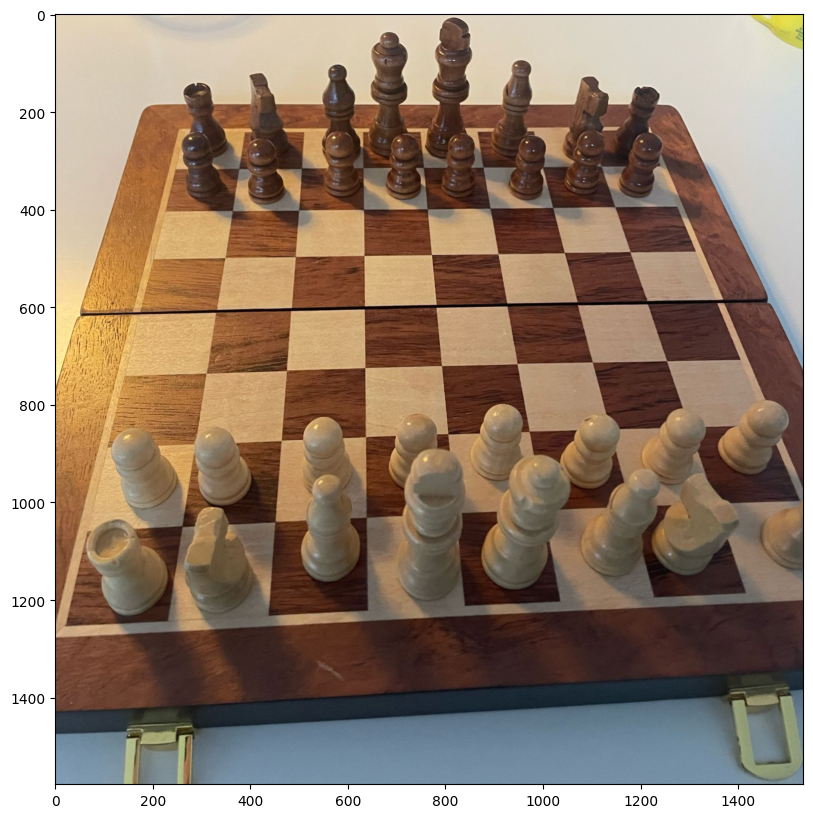

In [11]:
path = 'data\chessboard\chessboard_10.jpg'
image = cv2.imread(path)
corners = detect_corners(image)
warped = warp_perspective(image, corners)
plt.figure(figsize=(30, 10))
plt.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
plt.show()


In [6]:
# returns the angle between two vectors ab and ac
def get_angle(ab, ac):
    x = np.clip((ab @ ac) / np.linalg.norm(ab) / np.linalg.norm(ac), -1, 1)
    return np.degrees(np.arccos(x)) if not np.isnan(x) else 0

# check if the set of points form a square
def check_square(points):
    if len(points) != 4:
        return 4 * 90 ** 2, 0
    a, b, c, d = np.squeeze(points)
    bcd = get_angle(b - c, d - c)
    cda = get_angle(c - d, a - d)
    dab = get_angle(d - a, b - a)
    abc = get_angle(a - b, c - b)

    return np.sum((np.array([bcd, cda, dab, abc]) - 90) ** 2), np.mean(np.abs([a - b, b - c, c - d, d - a]))

# count how many squares are inside the square of index i
def child_count(i, hierarchy, is_square):
    j = hierarchy[0, i, 2]
    if j < 0:
        return 0

    total = 0
    while hierarchy[0, j, 0] > 0:
        j = hierarchy[0, j, 0]
    while j > 0:
        if is_square[j]:
            total += 1# + child_count(j, hierarchy, is_square)
        j = hierarchy[0, j, 1]
    return total

def get_contours(image, blur_radius):
    edge_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edge_image = cv2.GaussianBlur(edge_image, (blur_radius, blur_radius), 2)
    edge_image = cv2.Canny(edge_image, 20, 200)
    edge_image = cv2.dilate(
        edge_image,
        cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10)),
        iterations=1
    )

    # find the contours and hierarchy
    contours, hierarchy = cv2.findContours(edge_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Approximate every contour group to a simpler polygon
    contours = [cv2.approxPolyDP(cnt, 0.04 * cv2.arcLength(cnt, True), True) for cnt in contours]

    return contours, hierarchy

def get_candidate_boards(contours, hierarchy, max_error, min_side, min_child):
    square_info = list(map(lambda contour: check_square(contour), contours))
    is_square = list(map(lambda info: info[0] < max_error and info[1] > min_side, square_info))

    squares = []
    for i, square_flag, (error, side), contour in zip(range(len(contours)), is_square, square_info, contours):
        if square_flag:
            cnt = child_count(i, hierarchy, is_square)
            if cnt > min_child:
                squares.append(contour)

    return squares

def preprocess(image):
    all_boards = []

    for blur in (3, 5, 7, 9, 11):
        contours, hierarchy = get_contours(image, blur)
        boards = get_candidate_boards(contours, hierarchy, 4 * 10 ** 2, 10, 10)
        all_boards.extend(boards)
        for board in boards:
            error, side = check_square(board)
    all_boards = list(map(lambda board: (board, check_square(board)[1]), all_boards))
    all_boards = sorted(all_boards, key=lambda board_side: board_side[1], reverse=True)
    best_board = (None, 0)
    for board, side in all_boards:
      if side >= best_board[1] * 0.9:
        best_board = (board, side)

    return best_board[0]



# rotate and crop the image, given the points of the new border
def crop_image(image, points, rotate=False):
    points = np.squeeze(points)
    if rotate:
        low, high = points[np.lexsort((points[:, 1], points[:, 0]))[:2]]
        angle = -get_angle(np.array([0, 1]), high - low)
        if angle < -90:
            angle, low, high = angle + 180, high, low

        rot = cv2.getRotationMatrix2D((int(low[0]), int(low[1])), angle, 1.0)
        h, w = image.shape[:2]
        image = cv2.warpAffine(image, rot, (w, h))
        points = np.concatenate((points, np.ones(points.shape[0]).reshape((-1, 1))), axis=1)
        points = (rot @ points.T).T.astype(np.int32)

    y_min, y_max = points[:, 1].min(), points[:, 1].max()
    x_min, x_max = points[:, 0].min(), points[:, 0].max()

    # Ajout de la marge en haut
    y_min = max(0, y_min-200)

    image = image[y_min:y_max, x_min:x_max]

    # Faire de la détection de contour ici et crop
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        image_width = image.shape[1]

        # Chercher le point le plus haut, en excluant ceux sur les bords gauche et droit
        highest_point = min(
            largest_contour, 
            key=lambda point: point[0][1] if 0 < point[0][0] < image_width - 100 else 1000000
        )
        y_min = highest_point[0][1]

        image = image[y_min:]

    return image



Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_1.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_2.jpg.


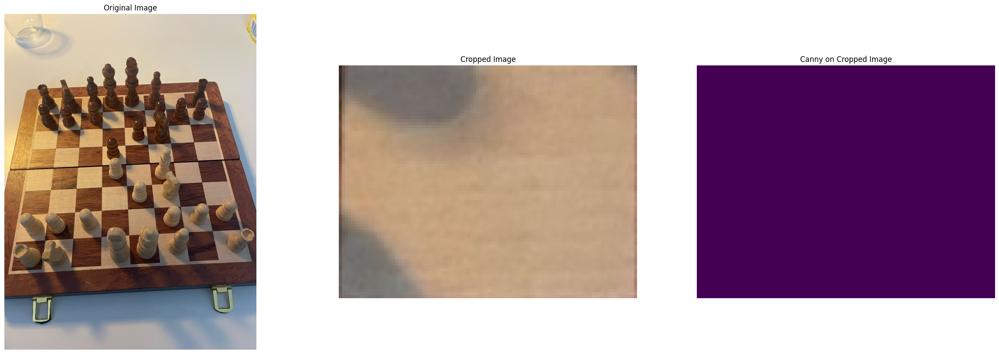

Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_4.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_5.jpg.


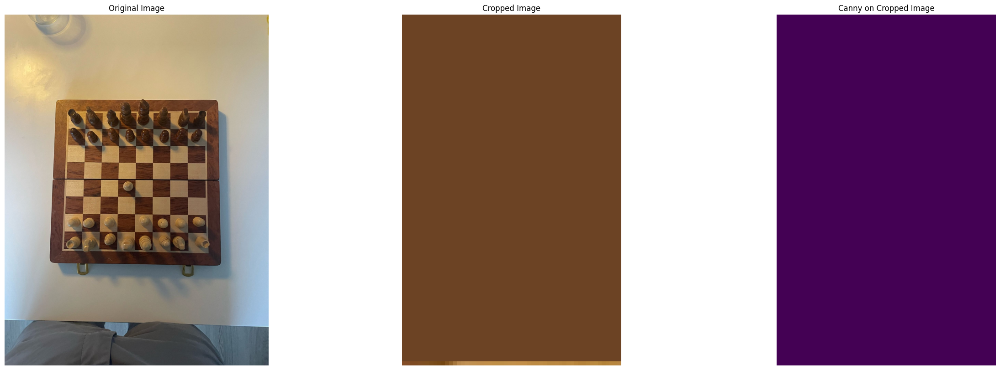

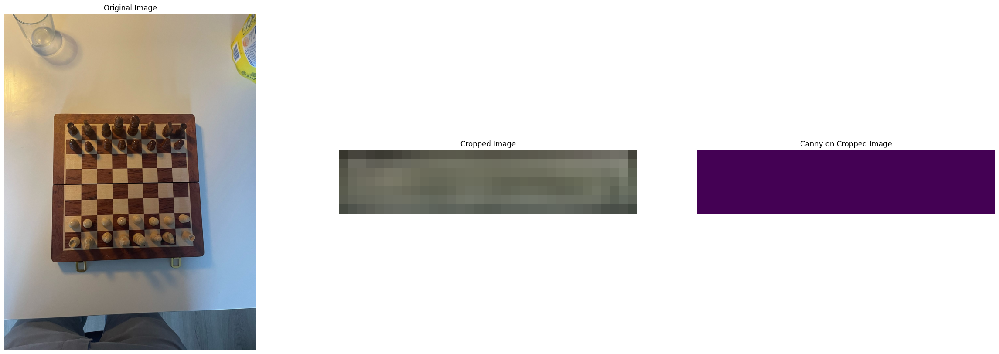

Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_8.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_9.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_10.jpg.


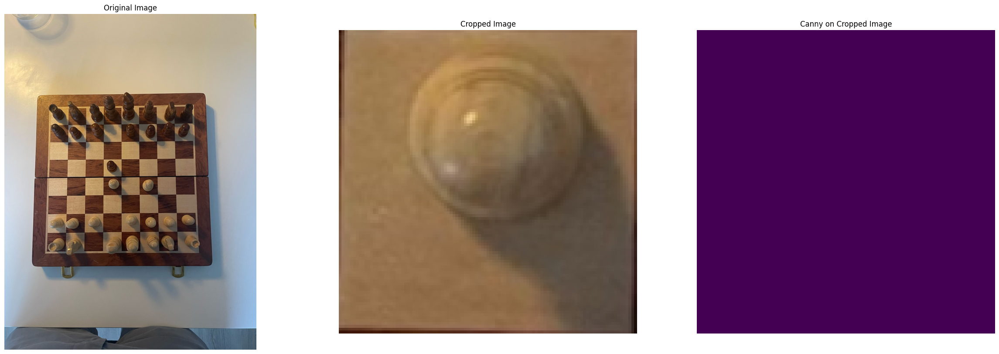

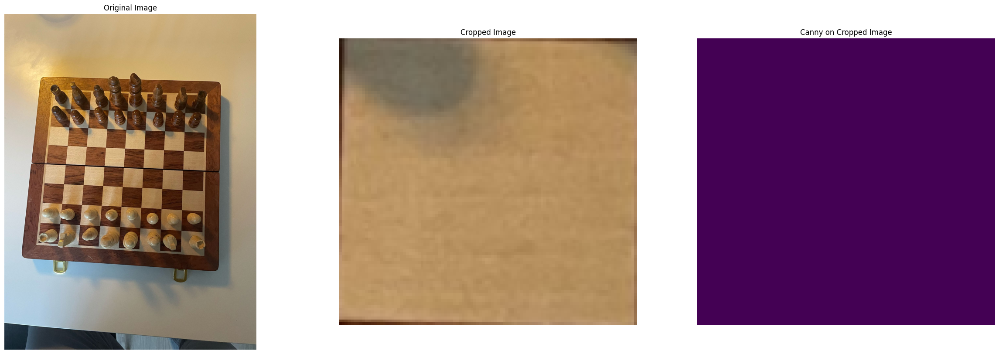

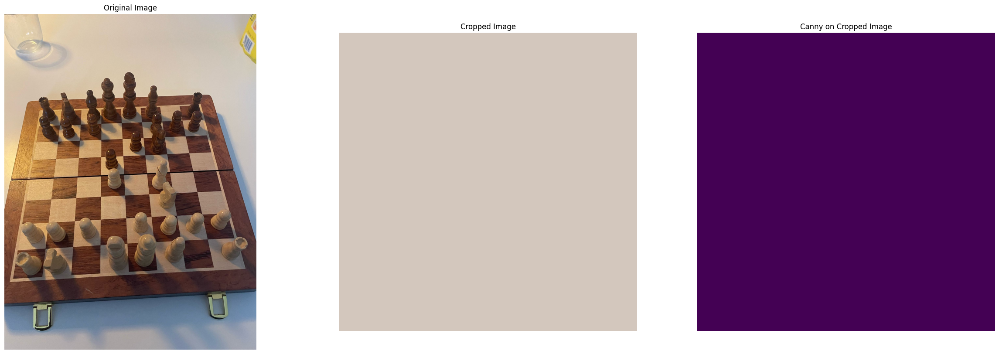

In [7]:
INPUT_SIZE = 1024

for i in range(1, 14):
    chessboard_image_path = chessboard_folder + f'/chessboard_{i}.jpg'
    image = cv2.imread(chessboard_image_path)
    board = preprocess(image)
    
    if board is None or len(board) == 0:
        print(f"Aucun carré détecté, impossible de découper l'image {chessboard_image_path}.")
    else:
        cropped = crop_image(image, board, rotate=True)
        cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

        corners = detect_corners(cropped)
        cropped = warp_perspective(cropped, corners)
        
        # Convert BGR to RGB for correct display with Matplotlib
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        cropped_rgb = cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB)

        # Canny on cropped
        cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
        # noise = np.random.normal(0, 100, cropped_gray.shape).astype(np.uint8)
        # cropped_noisy = cv2.add(cropped_gray, noise)
        cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
        edges = cv2.Canny(cropped_blur, 50, 150)

        
        # Display both images side by side
        plt.figure(figsize=(30, 10))  # Set the figure size
        plt.subplot(1, 3, 1)  # Subplot for the original image
        plt.imshow(image_rgb)
        plt.title("Original Image")
        plt.axis('off')
        
        plt.subplot(1, 3, 2)  # Subplot for the cropped image
        plt.imshow(cropped_rgb)
        plt.title("Cropped Image")
        plt.axis('off')

        plt.subplot(1,3,3)
        plt.imshow(edges)
        plt.title("Canny on Cropped Image")
        plt.axis('off')
        
        plt.show()

In [18]:
def detect_straight_lines(edges, threshold=100, min_line_length=50, max_line_gap=10):
    """
    Détecte les lignes droites sur une image de bords (Canny) en utilisant la transformée de Hough.
    :param edges: Image binaire des bords obtenue avec Canny.
    :param threshold: Seuil pour la détection des lignes.
    :param min_line_length: Longueur minimale pour qu'une ligne soit prise en compte.
    :param max_line_gap: Distance max entre deux segments pour être considérés comme une seule ligne.
    :return: Liste des lignes détectées sous forme de tuples (x1, y1, x2, y2).
    """
    lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=threshold,
                            minLineLength=min_line_length, maxLineGap=max_line_gap)
    
    return [] if lines is None else [tuple(line[0]) for line in lines]


Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.


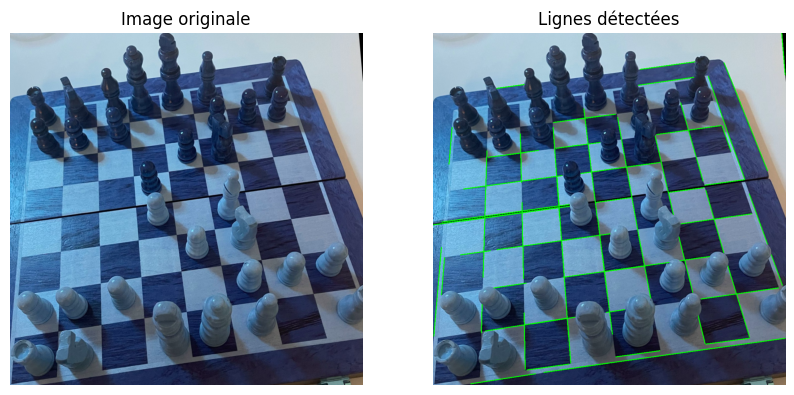

Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.


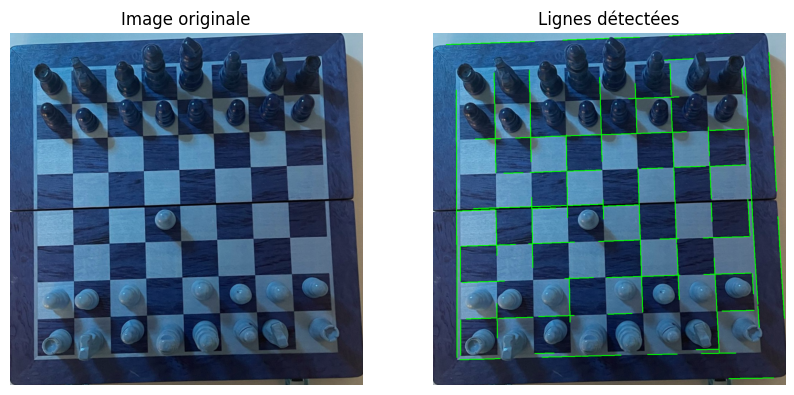

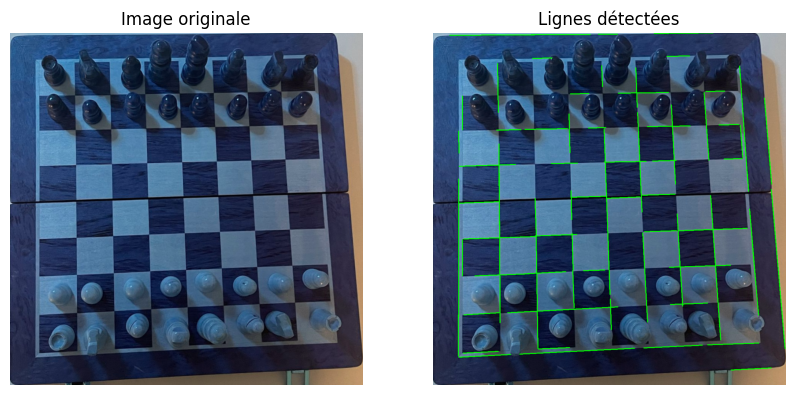

Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.
Aucun carré détecté, impossible de découper l'image data/chessboard/chessboard_13.jpg.


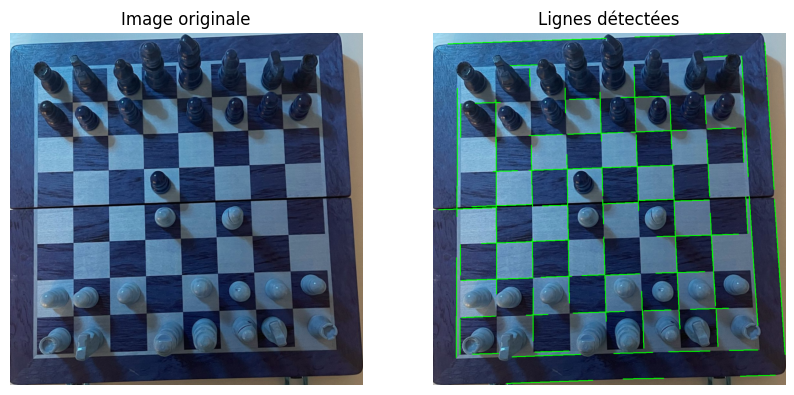

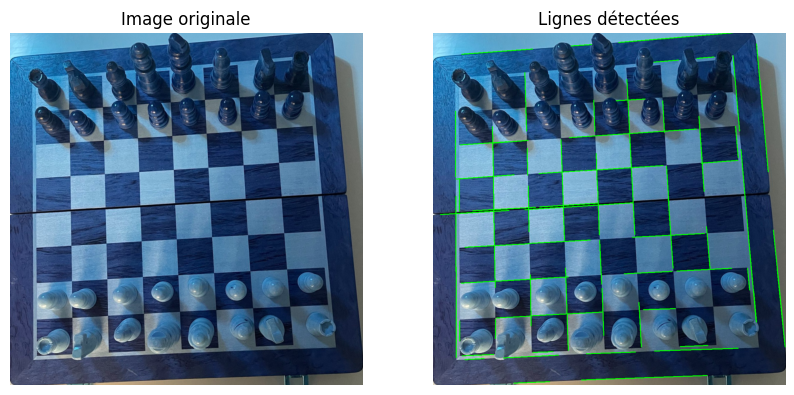

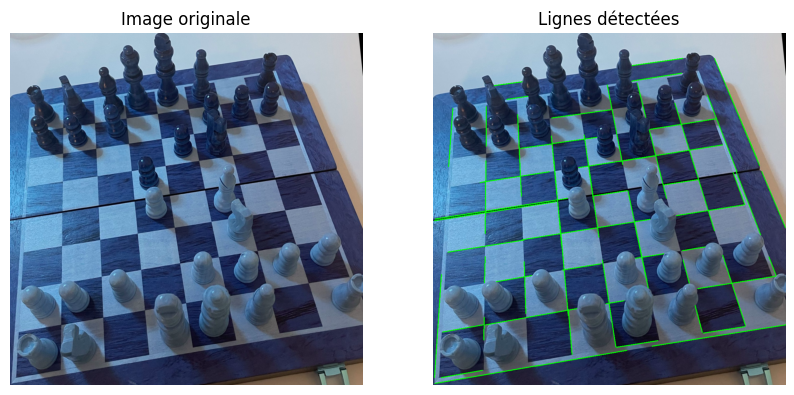

In [512]:
for i in range(1,14):
    # Charger une image et détecter ses bords
    image = cv2.imread(f"data\chessboard\chessboard_{i}.jpg")  # Remplace avec ton image
    board = preprocess(image)

    if board is None or len(board) == 0:
        print(f"Aucun carré détecté, impossible de découper l'image {chessboard_image_path}.")
    else:
        cropped = crop_image(image, board, rotate=True)
        cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)
        
        # Convert BGR to RGB for correct display with Matplotlib
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        cropped_rgb = cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB)

        cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
        # noise = np.random.normal(0, 100, cropped_gray.shape).astype(np.uint8)
        # cropped_noisy = cv2.add(cropped_gray, noise)
        cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
        edges = cv2.Canny(cropped_blur, 50, 150)

        # Détection des lignes droites
        lines = detect_straight_lines(edges)

        # Dessiner les lignes détectées
        image_with_lines = cropped_rgb.copy()
        for x1, y1, x2, y2 in lines:
            cv2.line(image_with_lines, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Lignes vertes

        # Affichage avec Matplotlib
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(cropped_rgb, cv2.COLOR_BGR2RGB))
        plt.title("Image originale")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(image_with_lines, cv2.COLOR_BGR2RGB))
        plt.title("Lignes détectées")
        plt.axis("off")

        plt.show()

In [17]:
def extend_line(x1, y1, x2, y2, img_shape):
    """
    Prolonge une ligne (x1, y1, x2, y2) en respectant son angle, pour qu'elle couvre toute l'image.
    """
    height, width = img_shape[:2]

    # Calcul de l'angle et direction
    if x2 != x1:
        slope = (y2 - y1) / (x2 - x1)  # Pente de la ligne
        y_intercept = y1 - slope * x1  # Ordonnée à l'origine

        # Prolongement vers la gauche (x = 0) et la droite (x = width)
        x_left, y_left = 0, int(y_intercept)
        x_right, y_right = width, int(slope * width + y_intercept)

        # Clamping des valeurs pour rester dans l'image
        if y_left < 0 or y_left > height:
            y_left = max(0, min(y_left, height))
            x_left = int((y_left - y_intercept) / slope)

        if y_right < 0 or y_right > height:
            y_right = max(0, min(y_right, height))
            x_right = int((y_right - y_intercept) / slope)
        
        return (x_left, y_left, x_right, y_right)

    else:  # Cas particulier d'une ligne verticale
        return (x1, 0, x2, height)

def draw_extended_lines(image, lines):
    """
    Dessine les lignes prolongées sur l'image.
    """
    img_with_lines = image.copy()
    for x1, y1, x2, y2 in lines:
        extended_line = extend_line(x1, y1, x2, y2, img_with_lines.shape)
        cv2.line(img_with_lines, (extended_line[0], extended_line[1]), 
                 (extended_line[2], extended_line[3]), (0, 255, 0), 2)

    return img_with_lines

Aucun carré détecté, impossible de découper l'image 1.
Aucun carré détecté, impossible de découper l'image 2.


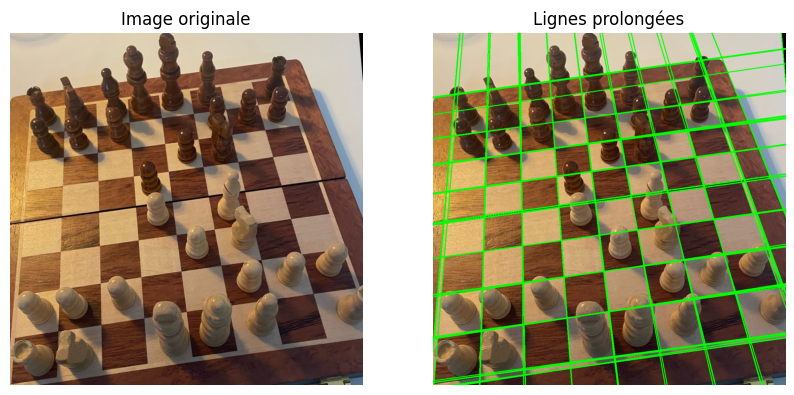

Aucun carré détecté, impossible de découper l'image 4.
Aucun carré détecté, impossible de découper l'image 5.


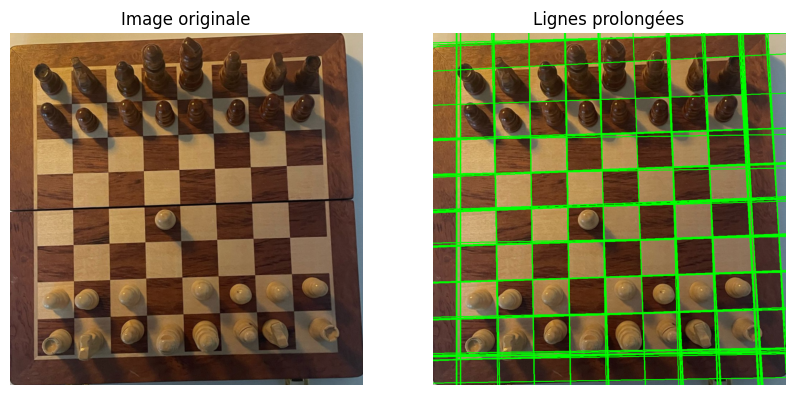

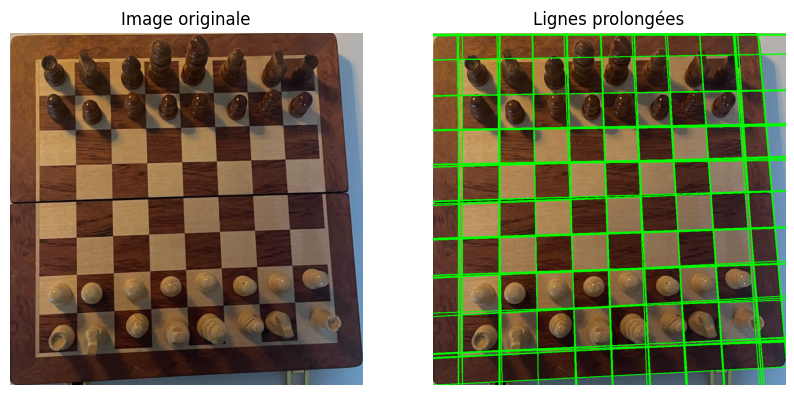

Aucun carré détecté, impossible de découper l'image 8.
Aucun carré détecté, impossible de découper l'image 9.
Aucun carré détecté, impossible de découper l'image 10.


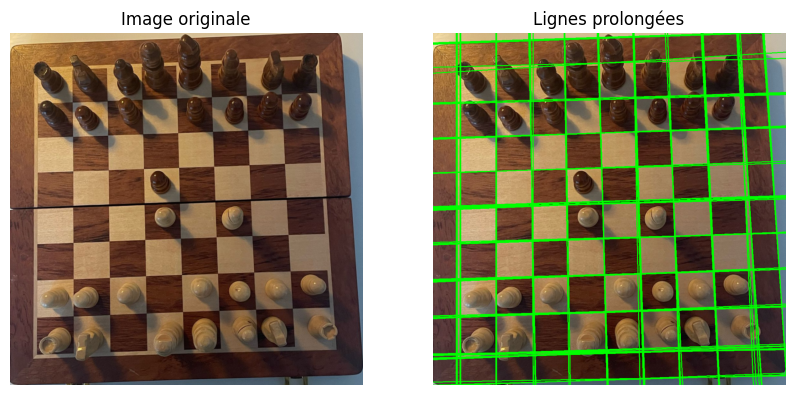

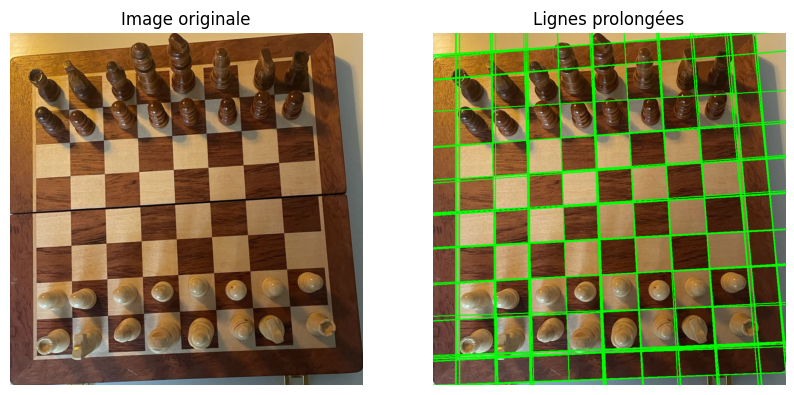

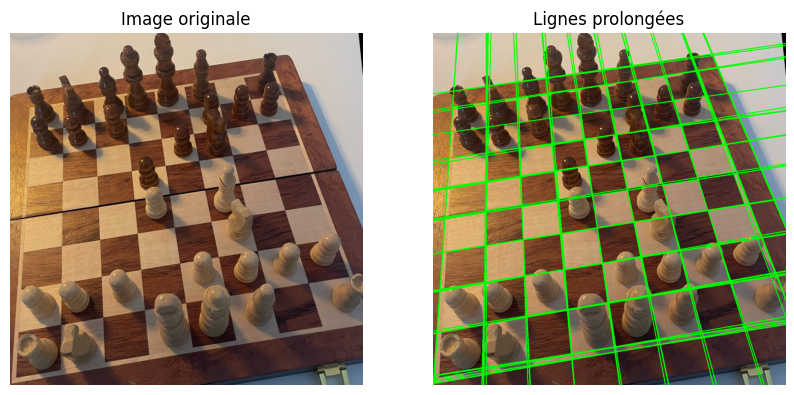

In [514]:
for i in range(1, 14):
    # Charger une image et détecter ses bords
    image = cv2.imread(f"data/chessboard/chessboard_{i}.jpg")
    board = preprocess(image)

    if board is None or len(board) == 0:
        print(f"Aucun carré détecté, impossible de découper l'image {i}.")
    else:
        cropped = crop_image(image, board, rotate=True)
        cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

        cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
        cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
        edges = cv2.Canny(cropped_blur, 50, 150)

        # Détection des lignes
        lines = detect_straight_lines(edges)

        # Prolonger et dessiner les lignes
        image_with_extended_lines = draw_extended_lines(cropped, lines)

        # Affichage avec Matplotlib
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
        plt.title("Image originale")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(image_with_extended_lines, cv2.COLOR_BGR2RGB))
        plt.title("Lignes prolongées")
        plt.axis("off")

        plt.show()

In [16]:
import math

def extended_lines(lines, image):
    extended_lines = []
    for x1, y1, x2, y2 in lines:
        extended_line = extend_line(x1, y1, x2, y2, image.shape)
        extended_lines.append(extended_line)
    return extended_lines

def avg_extended_lines(lines, image, threshold=30):
    extented_lines = extended_lines(lines, image)
    merged_lines = []
    merged = set()  # Utilisation d'un ensemble pour éviter les doublons et optimiser les recherches

    for x1, y1, x2, y2 in extented_lines:
        if (x1, y1, x2, y2) not in merged:
            to_merge = [(x1, y1, x2, y2)]
            for x3, y3, x4, y4 in extented_lines:
                if (x3, y3, x4, y4) not in merged and (x3, y3, x4, y4) not in to_merge:
                    if math.dist((x1, y1), (x3, y3)) < threshold and math.dist((x2, y2), (x4, y4)) < threshold:
                        to_merge.append((x3, y3, x4, y4))

            # Moyenne des points des lignes fusionnées
            avg_x1 = sum(x[0] for x in to_merge) // len(to_merge)
            avg_y1 = sum(x[1] for x in to_merge) // len(to_merge)
            avg_x2 = sum(x[2] for x in to_merge) // len(to_merge)
            avg_y2 = sum(x[3] for x in to_merge) // len(to_merge)

            # Ajout des lignes fusionnées à l'ensemble des lignes traitées
            merged.update(to_merge)
            merged_lines.append((avg_x1, avg_y1, avg_x2, avg_y2))
        
    return merged_lines

Aucun carré détecté, impossible de découper l'image 1.
Aucun carré détecté, impossible de découper l'image 2.


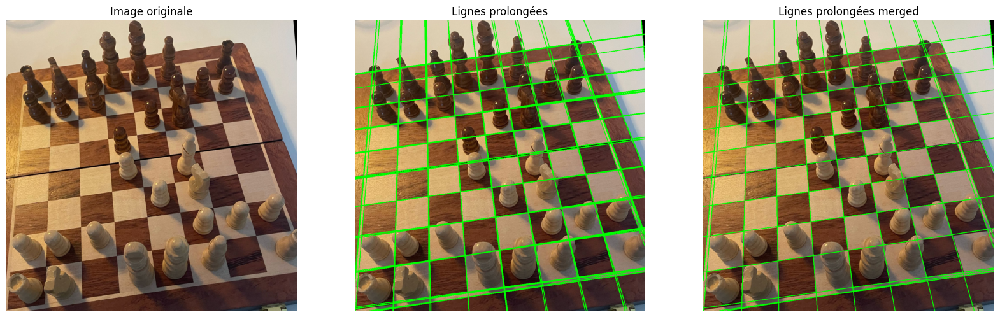

Aucun carré détecté, impossible de découper l'image 4.
Aucun carré détecté, impossible de découper l'image 5.


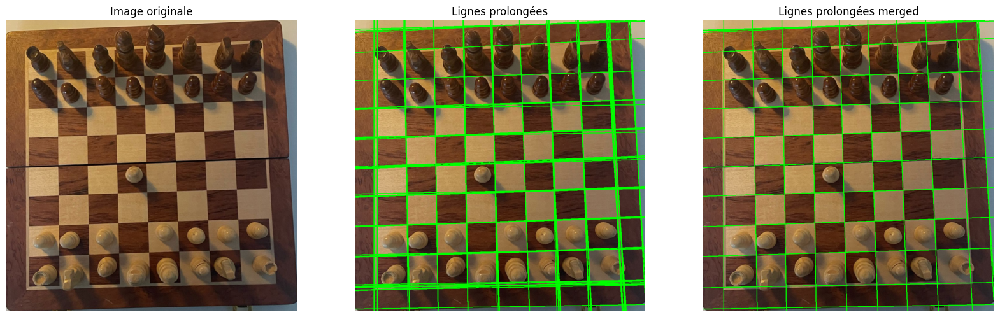

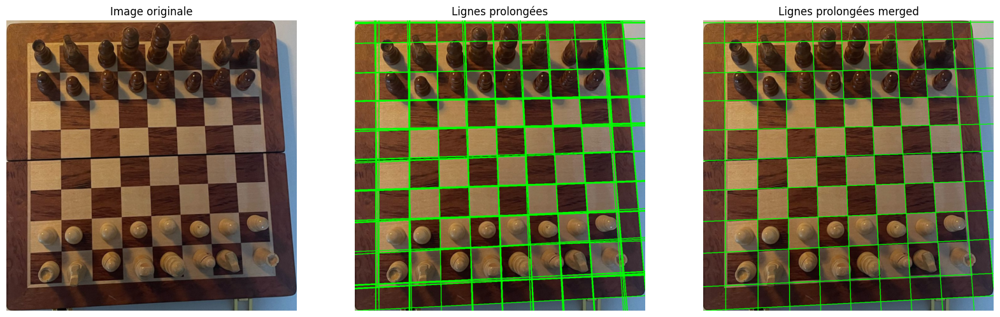

Aucun carré détecté, impossible de découper l'image 8.
Aucun carré détecté, impossible de découper l'image 9.
Aucun carré détecté, impossible de découper l'image 10.


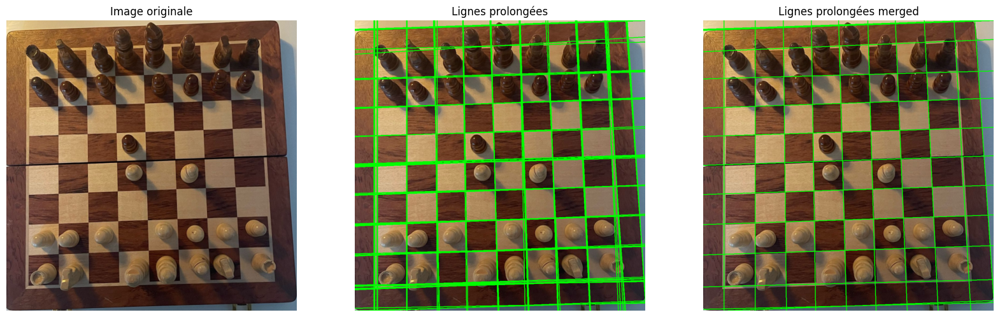

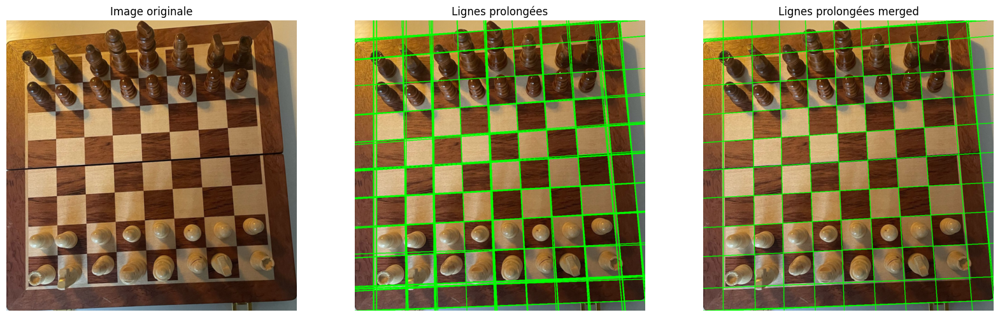

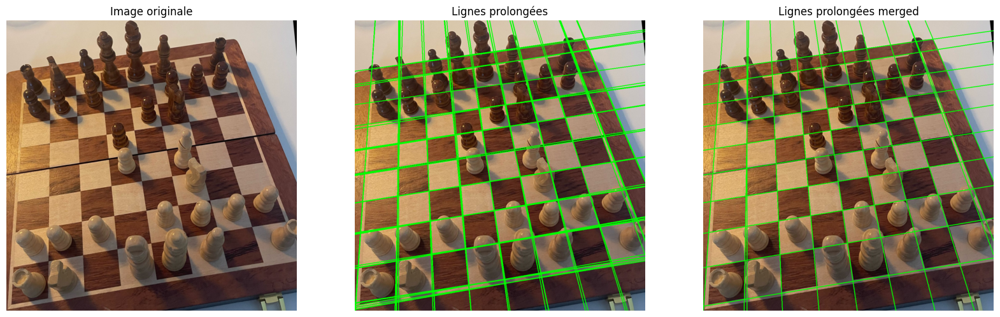

In [516]:
for i in range(1, 14):
    # Charger une image et détecter ses bords
    image = cv2.imread(f"data/chessboard/chessboard_{i}.jpg")
    board = preprocess(image)

    if board is None or len(board) == 0:
        print(f"Aucun carré détecté, impossible de découper l'image {i}.")
    else:
        cropped = crop_image(image, board, rotate=True)
        cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

        cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
        cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
        edges = cv2.Canny(cropped_blur, 50, 150)

        # Détection des lignes
        lines = detect_straight_lines(edges)
        grouped_lines = avg_extended_lines(lines, cropped)

        # Prolonger et dessiner les lignes
        image_with_extended_lines = draw_extended_lines(cropped, lines)
        image_with_merged_extended_lines = draw_extended_lines(cropped, grouped_lines)

        # Affichage avec Matplotlib
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 3, 1)
        plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
        plt.title("Image originale")
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(cv2.cvtColor(image_with_extended_lines, cv2.COLOR_BGR2RGB))
        plt.title("Lignes prolongées")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(cv2.cvtColor(image_with_merged_extended_lines, cv2.COLOR_BGR2RGB))
        plt.title("Lignes prolongées merged")
        plt.axis("off")

        plt.show()

In [15]:
def classify_lines(lines, img_width, margin=0.1):
    """
    Classe les lignes en quasi-horizontales ou quasi-verticales 
    en fonction de la position de leurs extrémités dans l'image.

    Paramètres :
        - lines : liste des lignes [(x1, y1, x2, y2)]
        - img_width : largeur de l'image (pour évaluer les limites gauche/droite)
        - margin : pourcentage de la largeur de l'image utilisé comme seuil (ex: 10%)

    Retour :
        - horizontal : liste des lignes horizontales
        - vertical : liste des lignes verticales
    """
    horizontal = []
    vertical = []

    left_limit = img_width * margin  # Seuil gauche
    right_limit = img_width * (1 - margin)  # Seuil droit

    for x1, y1, x2, y2 in lines:
        if (min(x1, x2) < left_limit) and (max(x1, x2) > right_limit):  
            horizontal.append((x1, y1, x2, y2))  # Lignes horizontales
        else:
            vertical.append((x1, y1, x2, y2))  # Lignes verticales

    return horizontal, vertical

def find_intersections(lines1, lines2):
    """Trouve les points d'intersection entre deux groupes de lignes en résolvant les équations des droites."""
    pts_on_vertical_lines = {}
    pts_on_horizontal_lines = {}
    intersections = []
    for (x1, y1, x2, y2) in lines1:
        for (x3, y3, x4, y4) in lines2:
            # Calcul des coefficients des droites
            denom = (x1 - x2) * (y3 - y4) - (y1 - y2) * (x3 - x4)
            if abs(denom) < 1e-6:  # Lignes parallèles
                continue

            # Calcul des coordonnées d'intersection
            px = ((x1 * y2 - y1 * x2) * (x3 - x4) - (x1 - x2) * (x3 * y4 - y3 * x4)) / denom
            py = ((x1 * y2 - y1 * x2) * (y3 - y4) - (y1 - y2) * (x3 * y4 - y3 * x4)) / denom

            # if 0 <= px <= cropped.shape[1] and 0 <= py <= cropped.shape[0]:  # Vérifie que le point est dans l'image
            intersections.append((int(px), int(py)))

            if (x1, y1, x2, y2) not in pts_on_horizontal_lines:
                pts_on_horizontal_lines[(x1, y1, x2, y2)] = [(int(px),int(py))]
            else:
                pts_on_horizontal_lines[(x1, y1, x2, y2)].append((int(px),int(py)))
            
            if (x3, y3, x4, y4) not in pts_on_vertical_lines:
                pts_on_vertical_lines[(x3, y3, x4, y4)] = [(int(px),int(py))]
            else:
                pts_on_vertical_lines[(x3, y3, x4, y4)].append((int(px),int(py)))

    return intersections, pts_on_horizontal_lines, pts_on_vertical_lines

Aucun échiquier détecté dans l'image 1.
Aucun échiquier détecté dans l'image 2.


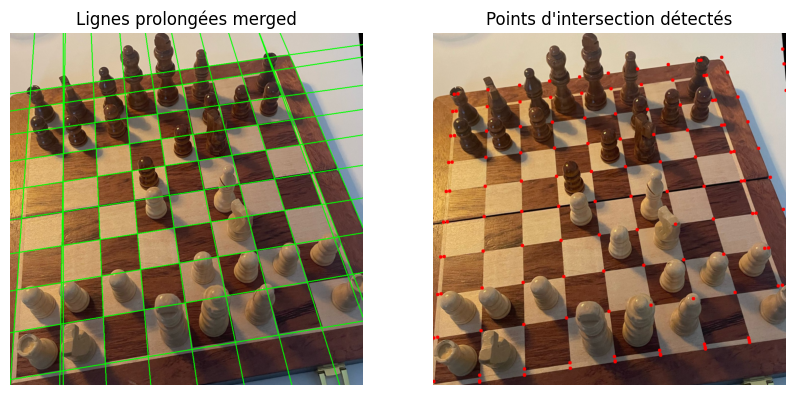

Aucun échiquier détecté dans l'image 4.
Aucun échiquier détecté dans l'image 5.


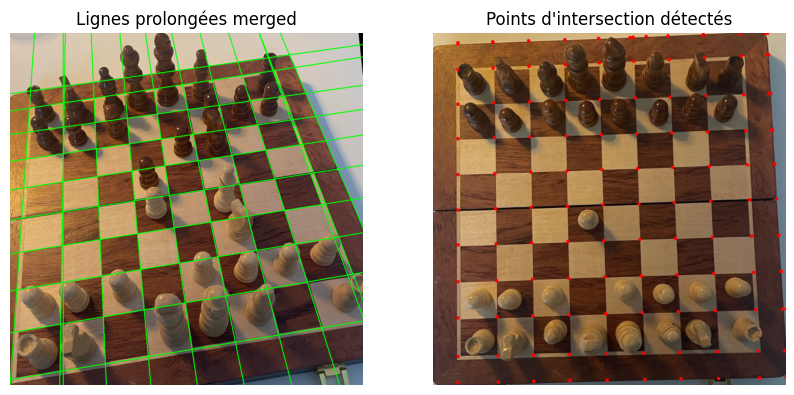

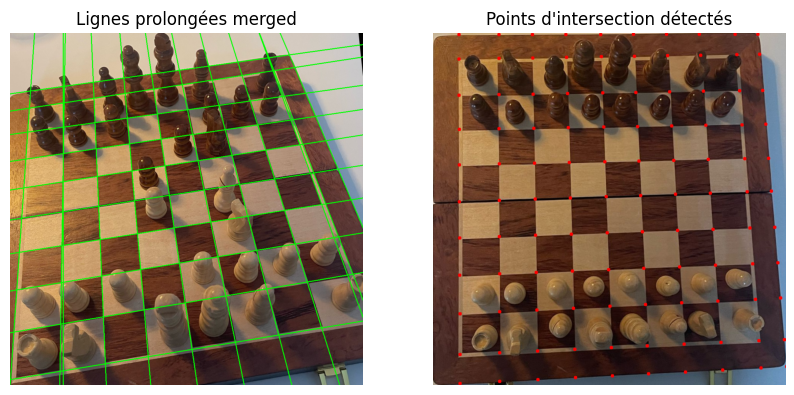

Aucun échiquier détecté dans l'image 8.
Aucun échiquier détecté dans l'image 9.
Aucun échiquier détecté dans l'image 10.


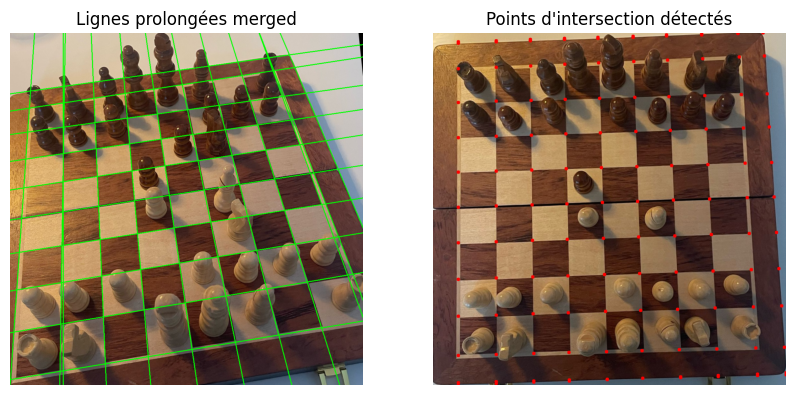

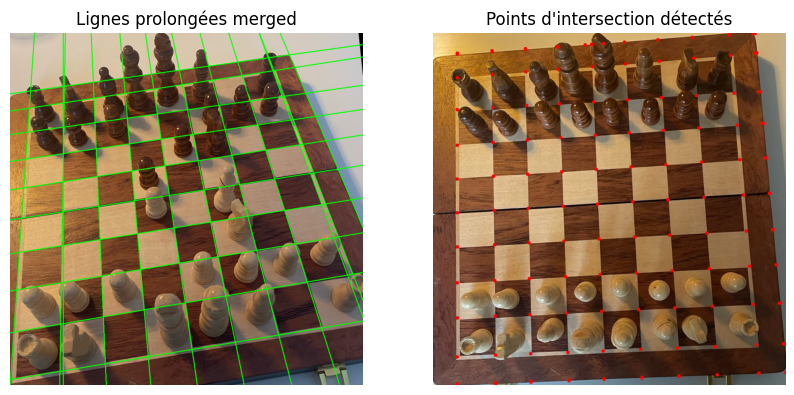

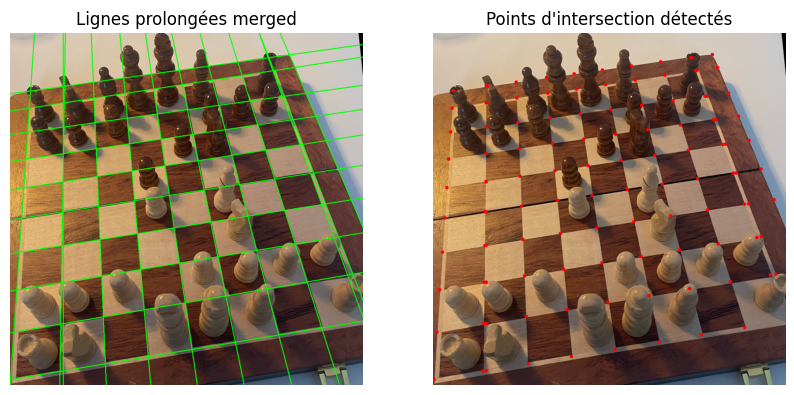

In [536]:
# Traitement de l'image
for i in range(1, 14):
    image = cv2.imread(f"data/chessboard/chessboard_{i}.jpg")
    board = preprocess(image)

    if board is None or len(board) == 0:
        print(f"Aucun échiquier détecté dans l'image {i}.")
        continue

    cropped = crop_image(image, board, rotate=True)
    cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

    cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
    cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
    edges = cv2.Canny(cropped_blur, 50, 150)

    lines = detect_straight_lines(edges)
    grouped_lines = avg_extended_lines(lines, cropped)

    # Classification avec tolérance d'angle
    horizontal_lines, vertical_lines = classify_lines(grouped_lines, cropped.shape[0])

    # Détection des intersections robustes
    intersections, pts_on_horizontal_lines, pts_on_vertical_lines = find_intersections(horizontal_lines, vertical_lines)

    # Affichage des points uniquement
    plt.figure(figsize=(10, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image_with_merged_extended_lines, cv2.COLOR_BGR2RGB))
    plt.title("Lignes prolongées merged")
    plt.axis("off")
    
    plt.subplot(1, 2, 2)
    cropped_copy = cropped.copy()
    for (px, py) in intersections:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Points d'intersection détectés")
    plt.show()

In [14]:
def most_regular_segment(points, min_length=8, max_length=9, threshold=0.5):
    """
    Trouve la séquence de 8 ou 9 points les plus régulièrement espacés,
    en priorisant une séquence de 9 si elle est acceptable.
    Si une séquence de 8 est choisie, on ajoute un 9ᵉ point à l'opposé du bord le plus proche.

    :param points: Liste de tuples (x, y) représentant les points d'une droite.
    :param min_length: Longueur minimale du segment (8 par défaut).
    :param max_length: Longueur maximale du segment (9 par défaut).
    :param threshold: Seuil d'écart-type maximal pour considérer une séquence de 9 comme acceptable.
    :return: Liste de 9 points les plus régulièrement espacés.
    """
    n = len(points)
    if n < min_length:
        return points  # Pas assez de points pour former un segment valide

    best_segment_9 = None
    best_segment_8 = None
    min_variation_9 = float('inf')
    min_variation_8 = float('inf')
    best_start_8 = None  # Indice du début du segment de 8

    # Essayer toutes les sous-séquences de taille 8 et 9
    for start in range(n):
        for length in [9, 8]:  # Priorité à 9
            end = start + length
            if end > n:
                continue
            
            segment = points[start:end]

            # Calcul des distances successives entre les points
            distances = [np.linalg.norm(np.array(segment[j+1]) - np.array(segment[j])) for j in range(len(segment) - 1)]
            
            # Calcul de l'écart-type des distances pour mesurer la régularité
            variation = np.std(distances)

            # Vérifier si c'est une séquence de 9 acceptable
            if length == 9 and variation < min_variation_9:
                min_variation_9 = variation
                best_segment_9 = segment

            # Vérifier si c'est une séquence de 8 meilleure
            if length == 8 and variation < min_variation_8:
                min_variation_8 = variation
                best_segment_8 = segment
                best_start_8 = start

    # Si la séquence de 9 est suffisamment régulière, la retourner
    if best_segment_9 and min_variation_9 <= threshold:
        return best_segment_9

    # Sinon, retourner la meilleure séquence de 8 et ajouter un point à l'opposé du bord le plus proche
    if best_segment_8:
        start = best_start_8
        end = start + 8

        # Déterminer les candidats à ajouter (point avant ou après la séquence)
        left_point = points[start - 1] if start > 0 else None
        right_point = points[end] if end < n else None

        # Trouver le bord le plus proche
        if left_point and right_point:
            left_dist = np.linalg.norm(np.array(left_point) - np.array(best_segment_8[0]))
            right_dist = np.linalg.norm(np.array(right_point) - np.array(best_segment_8[-1]))

            if left_dist < right_dist:
                best_segment_8.append(right_point)  # Ajouter à droite (opposé de gauche)
            else:
                best_segment_8.insert(0, left_point)  # Ajouter à gauche (opposé de droite)
        elif left_point:
            best_segment_8.append(left_point)  # Ajouter à droite si possible
        elif right_point:
            best_segment_8.insert(0, right_point)  # Ajouter à gauche si possible

        return best_segment_8

    return None 

def points_to_keep(pts_on_horizontal_lines, pts_on_vertical_lines):
    horizontal_points_to_keep = []
    for line in pts_on_horizontal_lines:
        sorted_points = sorted(pts_on_horizontal_lines[line], key=lambda x: x[0])
        regular_points = most_regular_segment(sorted_points)
        for point in regular_points:
            if point not in horizontal_points_to_keep:
                horizontal_points_to_keep.append(point)
    
    vertical_points_to_keep = []
    for line in pts_on_vertical_lines:
        sorted_points = sorted(pts_on_vertical_lines[line], key=lambda x: x[1])
        regular_points = most_regular_segment(sorted_points)
        for point in regular_points:
            if point not in vertical_points_to_keep:
                vertical_points_to_keep.append(point)
    
    points_to_keep = [point for point in horizontal_points_to_keep if point in vertical_points_to_keep]
    return points_to_keep

Aucun échiquier détecté dans l'image 1.
Aucun échiquier détecté dans l'image 2.


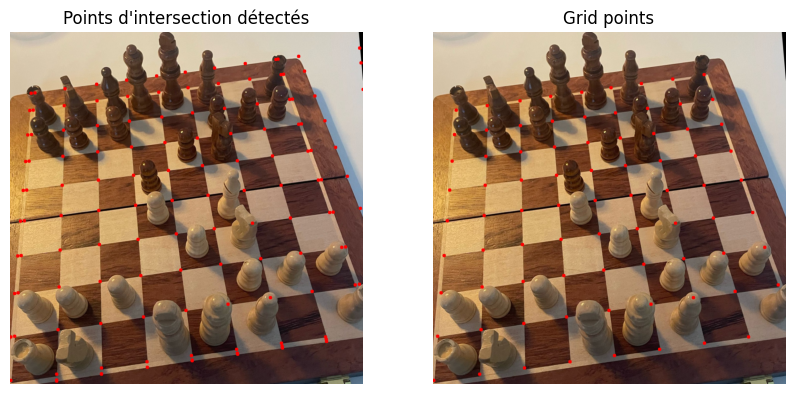

Aucun échiquier détecté dans l'image 4.
Aucun échiquier détecté dans l'image 5.


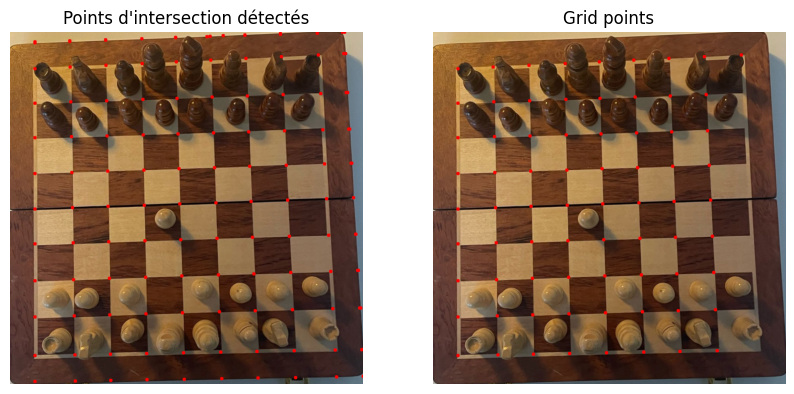

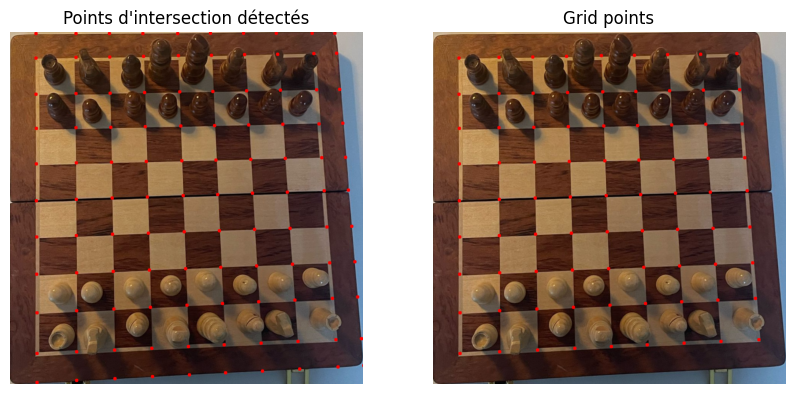

Aucun échiquier détecté dans l'image 8.
Aucun échiquier détecté dans l'image 9.
Aucun échiquier détecté dans l'image 10.


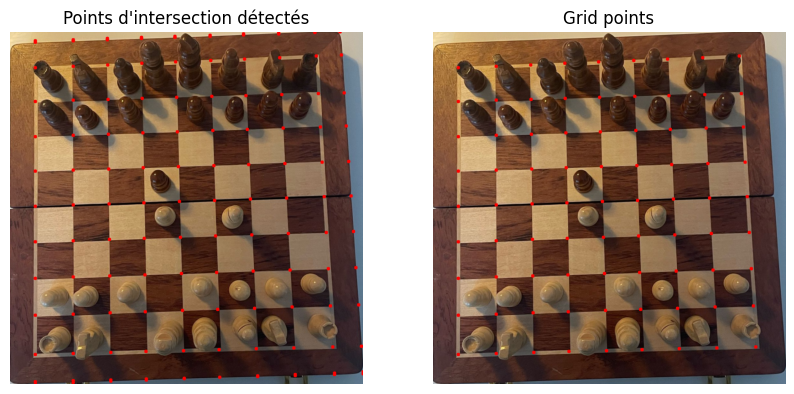

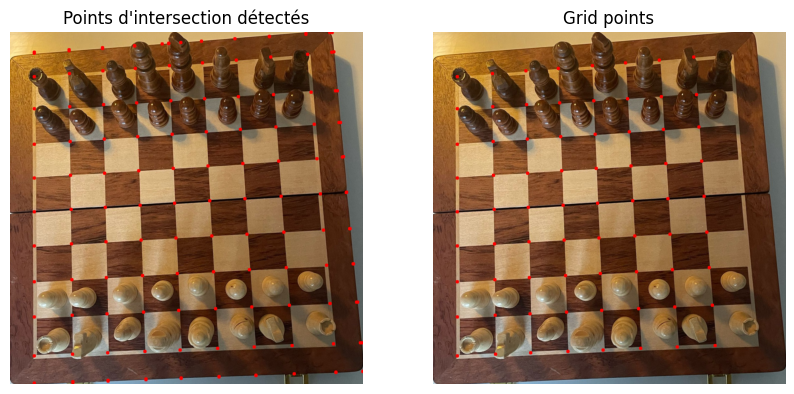

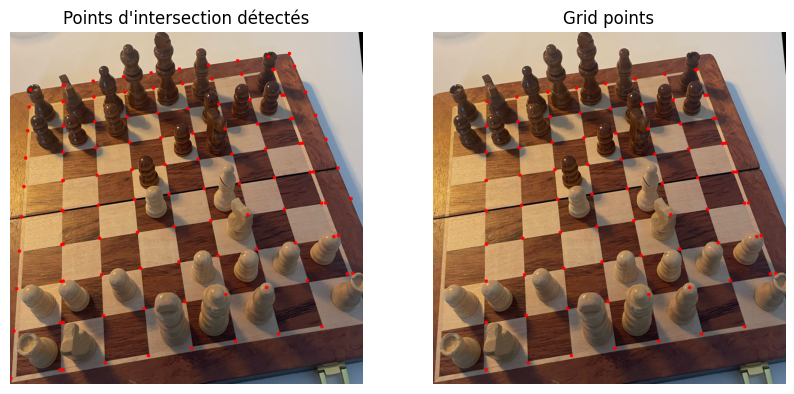

In [627]:
# Traitement de l'image
for i in range(1, 14):
    image = cv2.imread(f"data/chessboard/chessboard_{i}.jpg")
    board = preprocess(image)

    if board is None or len(board) == 0:
        print(f"Aucun échiquier détecté dans l'image {i}.")
        continue

    cropped = crop_image(image, board, rotate=True)
    cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

    cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
    cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
    edges = cv2.Canny(cropped_blur, 50, 150)

    lines = detect_straight_lines(edges)
    grouped_lines = avg_extended_lines(lines, cropped)

    # Classification avec tolérance d'angle
    horizontal_lines, vertical_lines = classify_lines(grouped_lines, cropped.shape[0])

    # Détection des intersections robustes
    intersections, pts_on_horizontal_lines, pts_on_vertical_lines = find_intersections(horizontal_lines, vertical_lines)

    # Grid points
    grid_points = points_to_keep(pts_on_horizontal_lines, pts_on_vertical_lines)

    # Affichage des points uniquement
    plt.figure(figsize=(10, 10))

    plt.subplot(1, 2, 1)
    cropped_copy = cropped.copy()
    for (px, py) in intersections:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Points d'intersection détectés")
    
    plt.subplot(1, 2, 2)
    cropped_copy = cropped.copy()
    for (px, py) in grid_points:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Grid points")
    plt.show()

In [13]:
# Fusionner les points proches en prenant la moyenne des coordonnées
def merge_close_points(points, threshold=30, image_size=(INPUT_SIZE, INPUT_SIZE)):
    merged_points = []
    points_to_delete = []
    
    def distance_to_border(point, image_size):
        # Calculer la distance du point aux bords de l'image
        x, y = point
        width, height = image_size
        return min(x, width - x, y, height - y)

    for point in points:
        # Si la liste est vide, ajouter le premier point
        if not merged_points:
            merged_points.append(point)
        else:
            # Calculer la distance entre le point actuel et le dernier point ajouté
            last_point = merged_points[-1]
            distance = np.linalg.norm(np.array(last_point) - np.array(point))

            if distance < threshold:
                # Comparer les distances aux bords des deux points
                distance_last_point = distance_to_border(last_point, image_size)
                distance_point = distance_to_border(point, image_size)
                
                # Supprimer le point le plus proche du bord
                if distance_last_point < distance_point:
                    points_to_delete.append(last_point)
                else:
                    points_to_delete.append(point)
            else:
                merged_points.append(point)

    merged_points = [point for point in merged_points if point not in points_to_delete]
    return merged_points

Aucun échiquier détecté dans l'image 1.
Aucun échiquier détecté dans l'image 2.


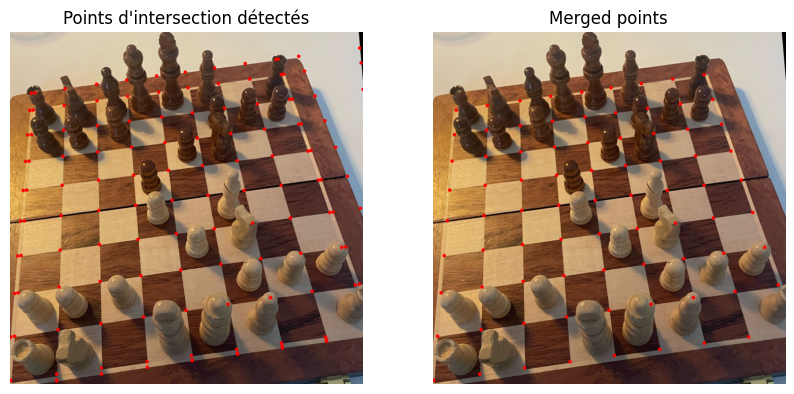

Aucun échiquier détecté dans l'image 4.
Aucun échiquier détecté dans l'image 5.


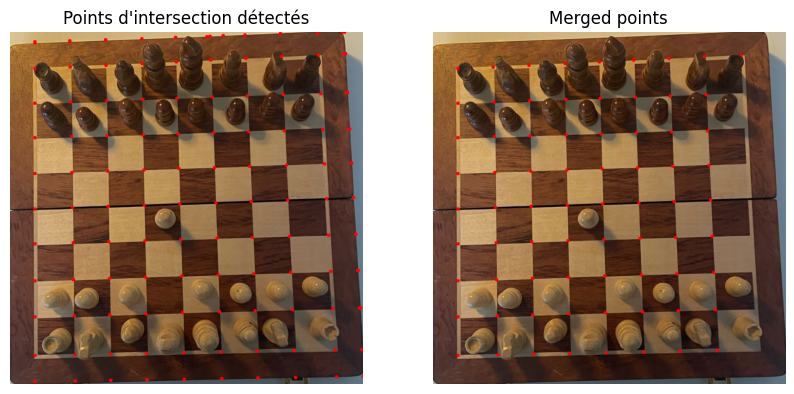

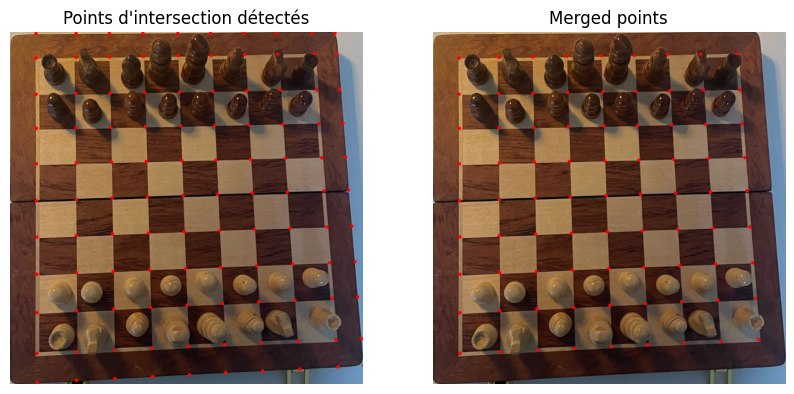

Aucun échiquier détecté dans l'image 8.
Aucun échiquier détecté dans l'image 9.
Aucun échiquier détecté dans l'image 10.


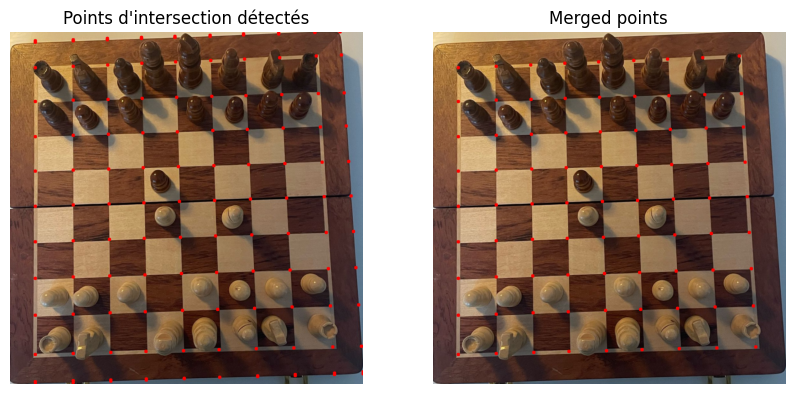

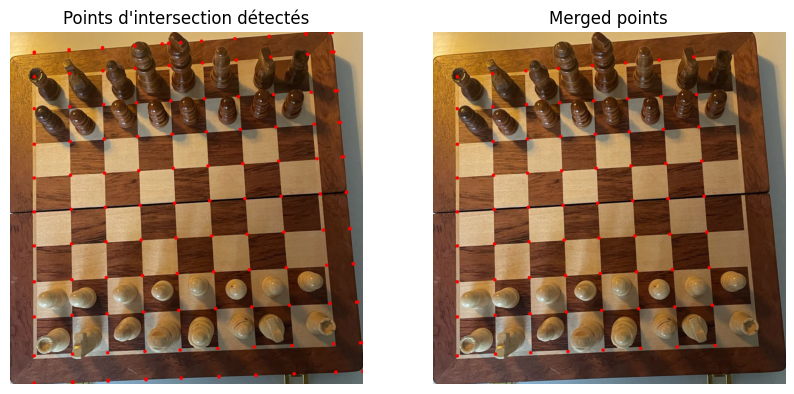

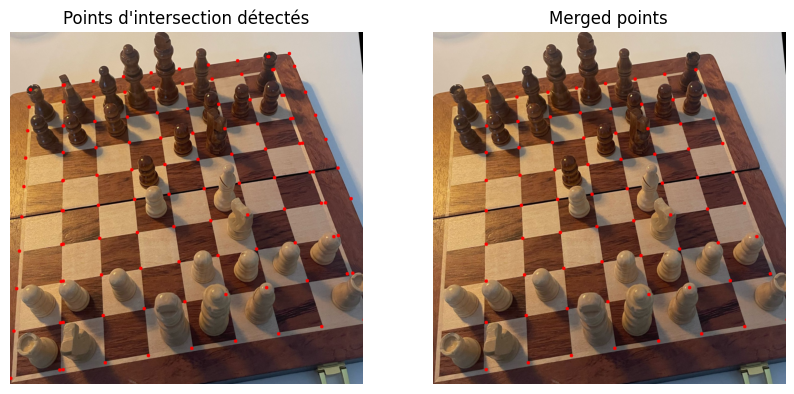

In [649]:
# Traitement de l'image
for i in range(1, 14):
    image = cv2.imread(f"data/chessboard/chessboard_{i}.jpg")
    board = preprocess(image)

    if board is None or len(board) == 0:
        print(f"Aucun échiquier détecté dans l'image {i}.")
        continue

    cropped = crop_image(image, board, rotate=True)
    cropped = cv2.resize(cropped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

    cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
    cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
    edges = cv2.Canny(cropped_blur, 50, 150)

    lines = detect_straight_lines(edges)
    grouped_lines = avg_extended_lines(lines, cropped)

    # Classification avec tolérance d'angle
    horizontal_lines, vertical_lines = classify_lines(grouped_lines, cropped.shape[0])

    # Détection des intersections robustes
    intersections, pts_on_horizontal_lines, pts_on_vertical_lines = find_intersections(horizontal_lines, vertical_lines)

    # Grid points
    grid_points = points_to_keep(pts_on_horizontal_lines, pts_on_vertical_lines)

    # Fusionner les points proches
    merged_points = merge_close_points(grid_points)


    # Affichage des points uniquement
    plt.figure(figsize=(10, 10))

    plt.subplot(1, 2, 1)
    cropped_copy = cropped.copy()
    for (px, py) in intersections:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Points d'intersection détectés")
    
    plt.subplot(1, 2, 2)
    cropped_copy = cropped.copy()
    for (px, py) in merged_points:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Merged points")
    plt.show()

In [ ]:
corners = detect_corners(image)
warped = warp_perspective(image, corners)

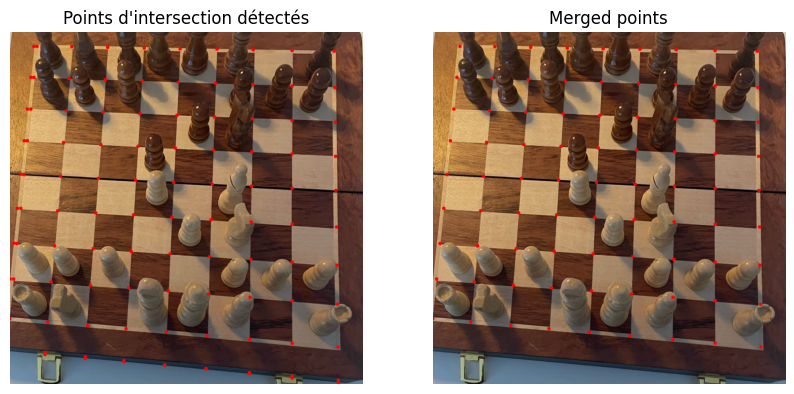

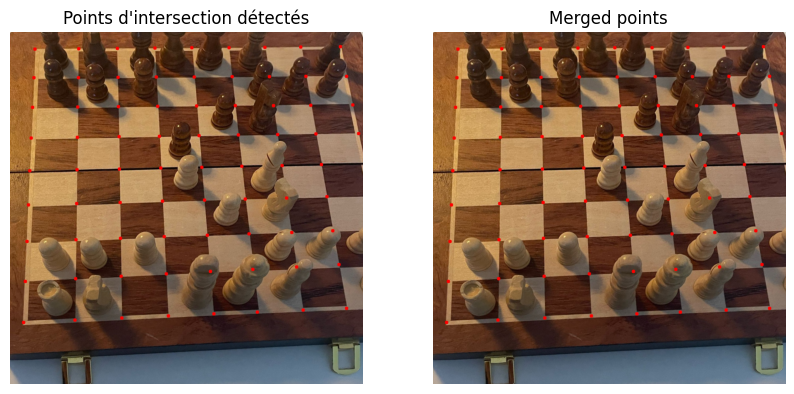

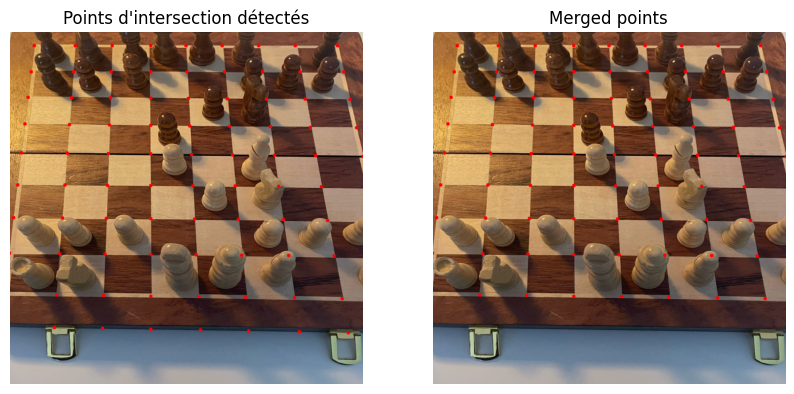

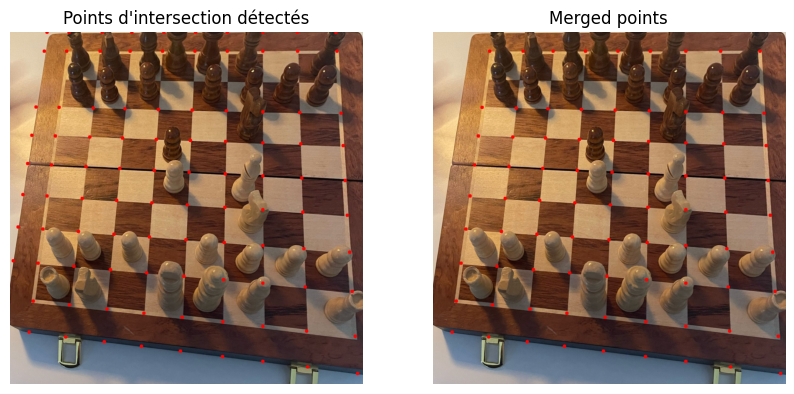

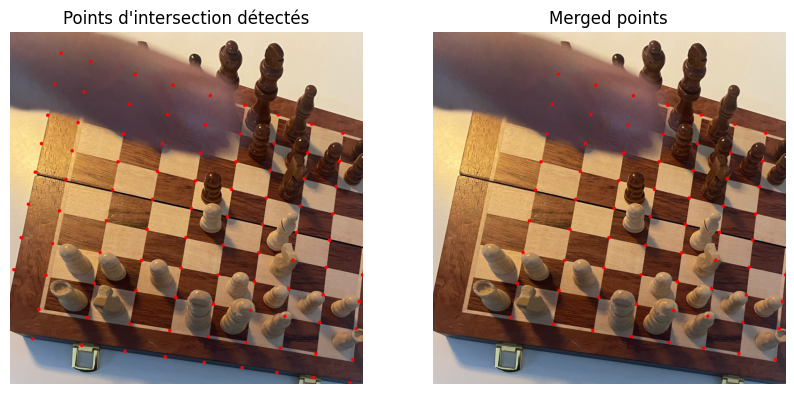

...

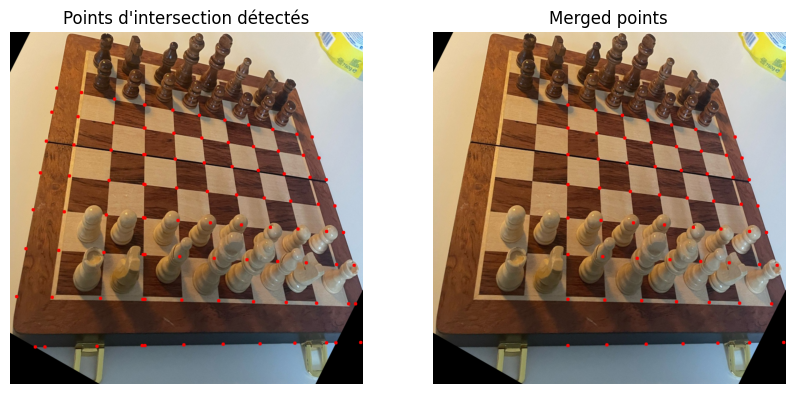

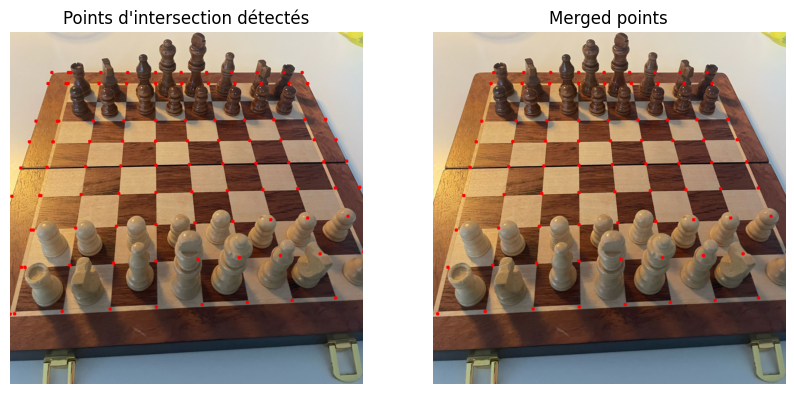

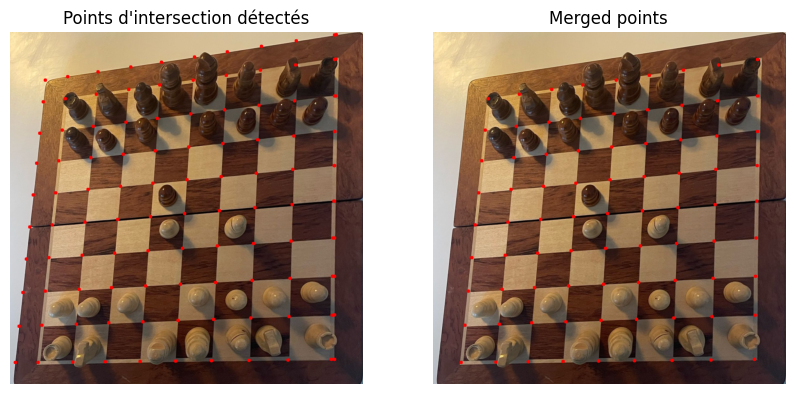

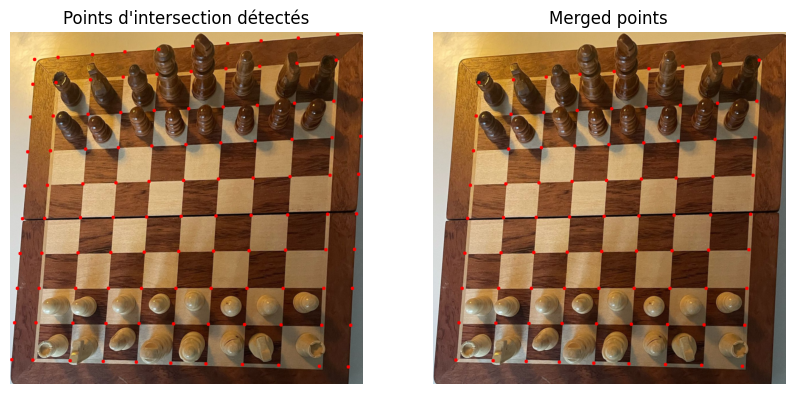

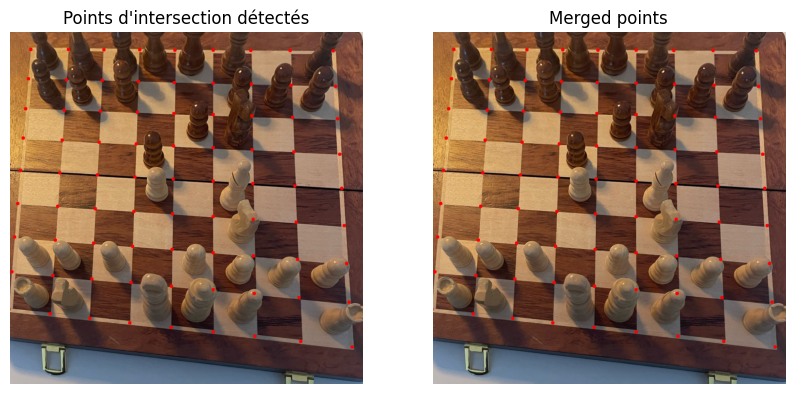

In [19]:
# Traitement de l'image
for i in range(1, 14):
    image = cv2.imread(f"data/chessboard/chessboard_{i}.jpg")
    # board = preprocess(image)
    corners = detect_corners(image)
    warped = warp_perspective(image, corners)

    # cropped = crop_image(image, board, rotate=True)
    cropped = cv2.resize(warped, (INPUT_SIZE, INPUT_SIZE), interpolation=cv2.INTER_AREA)

    cropped_gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
    cropped_blur = cv2.GaussianBlur(cropped_gray, (7, 7), 2)
    edges = cv2.Canny(cropped_blur, 50, 150)

    lines = detect_straight_lines(edges)
    grouped_lines = avg_extended_lines(lines, cropped)

    # Classification avec tolérance d'angle
    horizontal_lines, vertical_lines = classify_lines(grouped_lines, cropped.shape[0])

    # Détection des intersections robustes
    intersections, pts_on_horizontal_lines, pts_on_vertical_lines = find_intersections(horizontal_lines, vertical_lines)

    # Grid points
    grid_points = points_to_keep(pts_on_horizontal_lines, pts_on_vertical_lines)

    # Fusionner les points proches
    merged_points = merge_close_points(grid_points)


    # Affichage des points uniquement
    plt.figure(figsize=(10, 10))

    plt.subplot(1, 2, 1)
    cropped_copy = cropped.copy()
    for (px, py) in intersections:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Points d'intersection détectés")
    
    plt.subplot(1, 2, 2)
    cropped_copy = cropped.copy()
    for (px, py) in merged_points:
        cv2.circle(cropped_copy, (px, py), 5, (0, 0, 255), -1)  # Point rouge
    plt.imshow(cv2.cvtColor(cropped_copy, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Merged points")
    plt.show()